##
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
        4. Topic Modeling:
    </h2>
    

Topic modeling is a powerful technique used to extract topics or themes from a collection of text documents. When it comes to using topic modeling with the review column, the following steps can be considered:

**Note:** Due to the large number of rows in the `reviews_df` (one million rows), it would be computationally intensive and time-consuming to perform topic modeling directly on this dataset. Therefore, for the sake of efficiency and practicality, I will use the smaller `sampled_df` in the topic modeling process. While this approach may limit the generalizability of the results to some extent, it allows us to demonstrate the topic modeling process and visualize the outcomes in a reasonable timeframe.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
        1. Data Preprocessing:
    </h3>


Preprocess the review text by removing stopwords, punctuation, and special characters, convert text to lowercase, and perform stemming or lemmatization to reduce words to their root forms. This step is crucial to ensure that the topic modeling algorithm can effectively extract meaningful topics.

Since we have already performed text preprocessing, there is no need to repeat this step again. The text has been cleaned and prepared for topic modeling, enabling us to proceed directly to the next stages of vectorization, topic modeling algorithm selection, model training, and interpretation of the generated topics.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
2. Vectorization: 
</h3>


Convert the preprocessed text into a numerical format that can be used for modeling. Common approaches include Count Vectorization and Term Frequency-Inverse Document Frequency (TF-IDF) Vectorization.

We can use the TF-IDF Vectorization technique to convert the preprocessed text into a numerical format. TF-IDF stands for Term Frequency-Inverse Document Frequency, and it is a numerical representation that reflects the importance of each word in a document relative to the entire corpus.

In [9]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation

# Sampled dataframe 'sampled_df' containing the required columns
# Replace this with your actual dataframe
# sampled_df = pd.read_csv('path_to_sampled_df.csv')  # Load your data here

# Convert 'processed_text' column to string
sampled_df['processed_text'] = sampled_df['processed_text'].astype(str)

# Vectorization (using TF-IDF)
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(sampled_df['processed_text'])

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
3. Choose a Topic Modeling Algorithm & Model Training:
</h3>


- Choose a Topic Modeling Algorithm: There are several topic modeling algorithms available, such as Latent Dirichlet Allocation (LDA), Non-negative Matrix Factorization (NMF), and Latent Semantic Analysis (LSA). Each algorithm has its strengths and weaknesses, so the choice of algorithm depends on the specific requirements and characteristics of the data.

- Model Training: Train the chosen topic modeling algorithm on the vectorized text data. This will result in a set of topics, each represented by a probability distribution of words.

In [10]:
# Step 2: Choose a Topic Modeling Algorithm (using LDA)
num_topics = 5  # You can adjust the number of topics as per your requirement
lda_model = LatentDirichletAllocation(n_components=num_topics, random_state=42)
lda_output = lda_model.fit_transform(tfidf_matrix)

In [11]:
# Add a new column 'topic' to sampled_df and assign topics to each review
sampled_df['topic'] = lda_output.argmax(axis=1)

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
4. Interpretation: 
</h3>

Analyze the generated topics to understand the main themes and patterns present in the reviews. You can inspect the most probable words in each topic and assign meaningful labels to the topics based on this analysis.

####  
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
A. Topic Keywords:
</h4>


Display the top keywords for each topic in a tabular format. This allows for a quick overview of the main themes associated with each topic

In [12]:
# Interpretation
# Get the feature names (words) from the TF-IDF vectorizer
feature_names = tfidf_vectorizer.get_feature_names_out()

# Function to get the top n words for each topic
def get_top_words(topic_idx, n_top_words):
    return [feature_names[i] for i in lda_model.components_[topic_idx].argsort()[:-n_top_words - 1:-1]]

# Create a DataFrame to store the top words for each topic
topic_words_df = pd.DataFrame(columns=[f"Topic {i+1}" for i in range(num_topics)])

# Get the top 10 words for each topic and store them in the DataFrame
n_top_words = 10
for i in range(num_topics):
    topic_words_df[f"Topic {i+1}"] = get_top_words(i, n_top_words)

# Print the DataFrame to see the top words for each topic
topic_words_df

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5
0,good,bad,love,best,nice
1,app,app,great,game,app
2,nan,boycott,ok,awesom,like
3,excel,get,use,app,game
4,thank,dont,app,easi,fun
5,amaz,cool,help,inform,much
6,super,cant,well,phone,play
7,applic,slow,work,ever,okay
8,perfect,updat,experi,wow,fantast
9,happi,friend,hi,wonder,download


Based on the most frequent words in each topic, we can assign the following names to the topics:

- Topic 1: Positive User Experience
- Topic 2: Negative User Experience
- Topic 3: Love and Positivity
- Topic 4: Gaming and Fun
- Topic 5: Appreciation and Satisfaction

####
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
 B. Word Clouds: 
</h4>

Create word clouds for each topic to visualize the most frequent words in each topic. Word clouds can provide an intuitive representation of the main themes within each topic.

In [ ]:
import pandas as pd
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output, State
import base64
from wordcloud import WordCloud
from io import BytesIO

# Sampled dataframe 'sampled_df' containing the required columns
# Replace this with your actual dataframe
# sampled_df = pd.read_csv('path_to_sampled_df.csv')  # Load your data here


# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    html.H1("Word Cloud Dashboard", style = {'text-align': 'center'}),
    
    # Dropdown to select the topic
    dcc.Dropdown(
        id='topic-dropdown',
        options=[{'label': 'Topic ' + str(topic), 'value': topic} for topic in sampled_df['topic'].unique()],
        value=sampled_df['topic'].unique()[0]
    ),
    
    # Placeholder for displaying the word cloud image
    html.Div([
        html.Img(id='word-cloud-image', style={'height': '600px', 'width': '1200px'}),
    ], style={'display': 'flex', 'justify-content': 'center', 'align-items': 'center', 'height': '100vh'}),
])

# Create a function to generate word cloud image for a specific topic
def generate_word_cloud(topic):
    reviews_text = ' '.join(sampled_df[sampled_df['topic'] == topic]['review'])
    wordcloud = WordCloud(width=1200, height=600, background_color='white').generate(reviews_text)
    return wordcloud

# Callback to update the word cloud image
@app.callback(
    Output('word-cloud-image', 'src'),
    Input('topic-dropdown', 'value')
)
def update_word_cloud(topic):
    word_cloud_img = generate_word_cloud(topic)
    word_cloud_img_bytes = BytesIO()
    word_cloud_img.to_image().save(word_cloud_img_bytes, format='PNG')
    word_cloud_img_base64 = base64.b64encode(word_cloud_img_bytes.getvalue()).decode('utf-8')
    src_attr = f'data:image/png;base64,{word_cloud_img_base64}'
    return src_attr

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


**Note:** I've launched the dashboard on a cloud server, enabling you to engage with it directly through the web.

In [105]:
from IPython.display import IFrame

# Specify the URL of the website
website_url = "https://app-reviews-dash-6.onrender.com"

# Set the width and height of the iframe
iframe_width = "1400px"
iframe_height = "700px"

# Create and display the iframe
IFrame(website_url, width=iframe_width, height=iframe_height)

####  
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
C. Topic Frequency Visualization:
</h4>


Visualize the distribution of topics in the reviews using bar charts or pie charts. This will give you an overview of how the topics are distributed in the dataset.

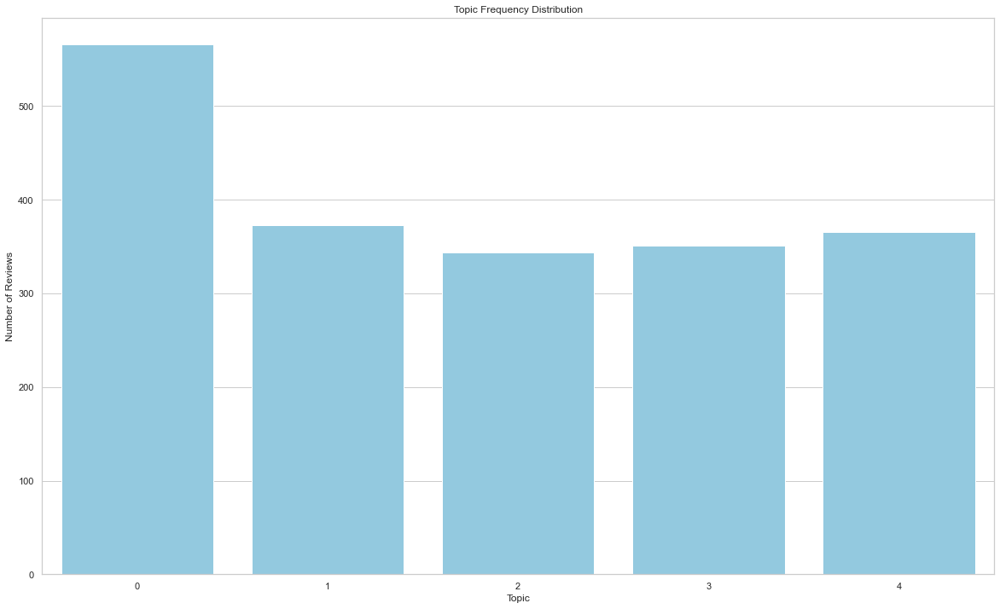

In [60]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sampled dataframe 'sampled_df' containing the required columns
# Replace this with your actual dataframe
# sampled_df = pd.read_csv('path_to_sampled_df.csv')  # Load your data here

# Assuming you already have the 'sampled_df' with a column 'topic' containing the assigned topic for each review

# Count the number of reviews belonging to each topic
topic_counts = sampled_df['topic'].value_counts()

# Set Seaborn style
sns.set(style="whitegrid")

# Plot the distribution using a bar chart with Seaborn
plt.figure(figsize=(20, 12))
sns.barplot(x=topic_counts.index, y=topic_counts.values, color='skyblue')
plt.xlabel('Topic')
plt.ylabel('Number of Reviews')
plt.title('Topic Frequency Distribution')
plt.xticks(rotation=0)
plt.show()

#### 
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
D. Topic Sentiment Analysis: Stacked Bar Plot of Sentiment Distribution by Topic
</h4>

his code generates a stacked bar plot to visualize the sentiment distribution within each topic obtained from the topic modeling and sentiment analysis of user reviews. Each bar in the plot represents a specific topic, while the segments of the bar display the proportion of positive, neutral, and negative sentiments. The sentiment scores are calculated using BERT Sentiment Analysis, allowing us to gain insights into the sentiment trends across different topics. The color-coded bars and hover tooltips provide an intuitive visualization of the sentiment composition for each topic, enabling a better understanding of user perceptions and reactions associated with specific aspects of the reviews.

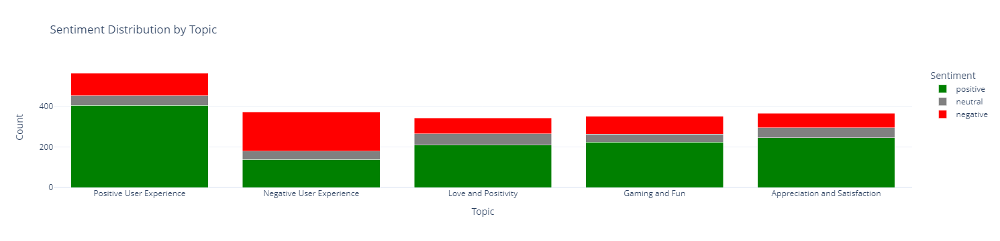

In [67]:
import pandas as pd
import plotly.express as px


# Convert bert_sentiment_score to a categorical data type with fixed order for proper stacking
sentiment_order = ['positive', 'neutral', 'negative']
sampled_df['bert_sentiment_score'] = pd.Categorical(sampled_df['bert_sentiment_score'], categories=sentiment_order)

# Group by 'topic' and 'bert_sentiment_score' and calculate the counts
sentiment_counts = sampled_df.groupby(['topic', 'bert_sentiment_score']).size().reset_index(name='count')

# Pivot the data to get the required format for the stacked bar plot
sentiment_pivot = sentiment_counts.pivot(index='topic', columns='bert_sentiment_score', values='count').fillna(0)

# Calculate the total count for each topic
sentiment_pivot['total'] = sentiment_pivot.sum(axis=1)

# Calculate the proportion of each sentiment for each topic
for sentiment in sentiment_order:
    sentiment_pivot[sentiment + '_prop'] = sentiment_pivot[sentiment] / sentiment_pivot['total']

# Topic names
topic_names = {
    0: 'Positive User Experience',
    1: 'Negative User Experience',
    2: 'Love and Positivity',
    3: 'Gaming and Fun',
    4: 'Appreciation and Satisfaction'
}

# Plot the stacked bar chart
fig = px.bar(sentiment_pivot,
             x=sentiment_pivot.index.map(topic_names),
             y=sentiment_order,
             labels={'x': 'Topic', 'y': 'Sentiment'},
             title='Sentiment Distribution by Topic',
             color_discrete_map={'positive': 'green', 'neutral': 'gray', 'negative': 'red'},
             hover_data={sentiment + '_prop': ':.2f' for sentiment in sentiment_order},
             template='plotly_white',
             barmode='stack'
            )

# Update layout for better visualization
fig.update_layout(
    xaxis=dict(title='Topic'),
    yaxis=dict(title='Count'),
    showlegend=True,
    legend_title_text='Sentiment',
    legend_traceorder='normal',  # This ensures legend items are in the same order as sentiment_order
)

fig.show()


#### 
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
E. Interactive Topic Visualization using t-SNE
</h4>

**Description:** This code demonstrates how to perform interactive topic visualization using t-SNE (t-distributed Stochastic Neighbor Embedding). The goal of this visualization is to explore the relationships between topics derived from a topic modeling algorithm (LDA) in a 2D space. By projecting the topic probabilities of documents onto a 2D plane, t-SNE creates a scatter plot where documents with similar topics are clustered together. This interactive plot allows users to interactively explore how topics are distributed and connected, gaining insights into the underlying patterns and structures in the text data.

**Instructions:**
1. Load your dataset containing the preprocessed text and topic assignments (labeled as 'processed_text' and 'topic' columns, respectively).
2. Apply TF-IDF vectorization to convert the preprocessed text into a numerical representation.
3. Utilize LatentDirichletAllocation (LDA) to perform topic modeling and obtain topic probabilities for each document.
4. Apply t-SNE to reduce the dimensionality of the topic probabilities, converting them into 2D coordinates for visualization.
5. Create an interactive scatter plot using Plotly to visualize the t-SNE results, with each point representing a document and color-coded by its assigned topic.
6. When interacting with the plot, users can hover over data points to view the corresponding topic label and explore the spatial distribution of topics in the dataset.

By using this interactive t-SNE visualization, data analysts and researchers can gain a deeper understanding of the relationships between topics within their text data, enabling better interpretation and insights into the thematic structure of the corpus.

For those who are interested in **delving deeper into the concepts of dimensionality reduction techniques**, I suggest reading the following articles:
1. [PCA vs. t-SNE: Understanding the Differences](https://medium.com/analytics-vidhya/pca-vs-t-sne-17bcd882bf3d)
2. [PCA vs. t-SNE: Key Differences and Use Cases](https://www.geeksforgeeks.org/difference-between-pca-vs-t-sne/#)

These articles provide valuable insights into the comparison between Principal Component Analysis (PCA) and t-SNE, which are widely used for reducing high-dimensional data into lower dimensions. Understanding the nuances of these techniques can further enhance your understanding of the t-SNE visualization and empower you to extract more meaningful information from your text data.

In [80]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE
import plotly.express as px

# Reduce dimensionality using t-SNE
tsne_model = TSNE(n_components=2, random_state=42)
tsne_topic_probs = tsne_model.fit_transform(lda_output)

# Create a DataFrame with t-SNE results and topic labels
tsne_df = pd.DataFrame(data=tsne_topic_probs, columns=['tsne_x', 'tsne_y'])
tsne_df['Topic'] = sampled_df['topic'].apply(lambda x: f'Topic {x+1}')

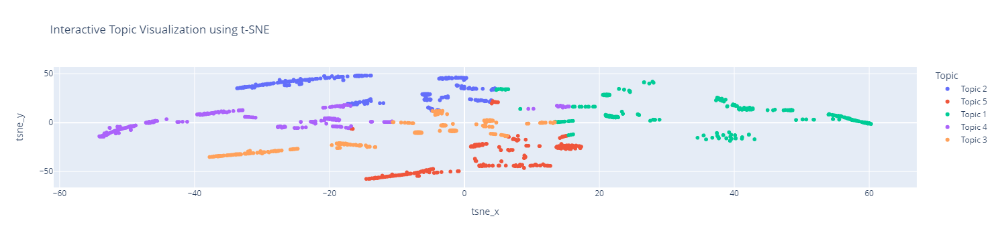

In [81]:
# Create the interactive t-SNE plot
fig = px.scatter(tsne_df, x='tsne_x', y='tsne_y', color='Topic', hover_name='Topic',
                 title='Interactive Topic Visualization using t-SNE')
fig.update_layout(height = 600)
# Show the plot
fig.show()

##
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       5. Exploring Topic Modeling with BertTopic
    </h2>
    
**Description:** BertTopic presents an innovative and powerful approach to topic modeling, offering a new perspective on understanding the underlying themes within textual data. Unlike traditional topic modeling techniques such as LDA, BertTopic leverages the capabilities of pre-trained BERT (Bidirectional Encoder Representations from Transformers) models, enabling it to capture the context and semantics of words more effectively.

This advanced technique combines BERT's language understanding with clustering algorithms to group similar documents into coherent topics. By employing this cutting-edge method, analysts can uncover hidden patterns, extract key themes, and gain deeper insights into complex and diverse text datasets.

By harnessing the power of BertTopic, researchers, data scientists, and NLP enthusiasts can unlock the full potential of topic modeling and elevate their understanding of intricate textual data, making it an essential addition to your toolkit for natural language processing and text analysis.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
Data Preparation: Utilizing Sampled Data for Effective BertTopic Topic Modeling
</h3>

**Note:** I will utilize a downsampled DataFrame from "reviews_df" called `sampled_bertopic_df`, containing 10,000 rows to ensure meaningful results in the topic modeling process with BertTopic. 

In [ ]:
# Set the desired number of rows for the sampled DataFrame
num_samples = 10000

# Create the downsampled DataFrame
sampled_bertopic_df = df_reviews.sample(n=num_samples, random_state=42)

# Reset the index of the new DataFrame
sampled_bertopic_df = sampled_bertopic_df.reset_index(drop=True)

# Check the dataframe
sampled_bertopic_df

In [95]:
# Delete:
# load the sampled_bertopic_df
sampled_bertopic_df = pd.read_csv('sampled_bertopic_df.csv')

In [ ]:
sampled_bertopic_df

Let's begin by installing the necessary libraries that we require.

In [ ]:
pip install --upgrade pip

In [ ]:
pip install bertopic

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
1. Import the essential libraries.
</h3>

In [ ]:
from bertopic import BERTopic
import json
import pandas as pd

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
2. Load the model and directly train it on the reviews data, as Bertopic can handle text without requiring any preprocessing.
</h3>

In [ ]:
topic_model = BERTopic(embedding_model="all-MiniLM-L6-v2")
topics, probs = topic_model.fit_transform(sampled_bertopic_df['review'])

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
3. Save and Load the topic_model
</h3>

In [ ]:
# Delete:

# Save the topic_model
topic_model.save("path_to_saved_model")

In [ ]:
# Load the topic_model
topic_model = BERTopic.load("topic_model.topic_model")

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
4. Get the topic names for each topic & Add the name of the topic to each row in the DataFrame
</h3>

In [ ]:
# Get the topic names for each topic
topic_names = topic_model.get_topic_freq().set_index('Topic').to_dict()['Name']

# Add the name of the topic to each row in the DataFrame
sampled_bertopic_df['topic_name'] = topics.map(topic_names)

# Now the 'sampled_df' DataFrame contains a new column 'topic_name' with the name of the topic for each row
sampled_df.head()

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
5. Obtain topic information in the form of a DataFrame & Retrieving topic keywords.Obtain topic information in the form of a DataFrame & Retrieving topic keywords.
</h3>

In [ ]:
# Get some Info on our Topics as a DataFrame
topic_model.get_topic_info()

In [ ]:
# Get the Keywords for a Topic
topic_model.get_topic(topic=0)
topic_model.get_representative_docs(0)

###
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
6. Create visualizations to gain insights into the results:
</h3>

####
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
1. Interactive Topic Visualization
</h4>

Explore the discovered topics and their distributions using an interactive plot. Each topic is represented as a group of related words, allowing you to gain insights into the main themes present in the analyzed text data. Use the interactive features to navigate and understand the composition of each topic in the context of your dataset.

In [ ]:
topic_model.visualize_topics()

Creating the visualization and saving it.

In [ ]:
import plotly.offline as pyo

# Assuming you have already created the topic_model object
fig = topic_model.visualize_topics()

# Save the plot to an HTML file
filename = "topic_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
pyo.iplot(fig)

In [ ]:
from IPython.display import IFrame

# Specify the path to the saved HTML file
saved_html_file = "visualizations for BarTopic\topic_visualization.html"

# Define the width and height for the embedded iframe (adjust as needed)
iframe_width = "1200px"
iframe_height = "800px"

# Display the saved plot using an iframe
IFrame(saved_html_file, width=iframe_width, height=iframe_height)

In [ ]:
from IPython.display import HTML

# URL of the raw HTML file on GitHub
saved_html_file = "https://raw.githubusercontent.com/ZaidAlmelhem/Dashboards/main/Distribution%20of%20Review%20Scores%20for%20Mobile%20Apps/topic_visualization.html"

# Read the HTML content
html_content = requests.get(saved_html_file).text

# Display the HTML content
HTML(html_content)

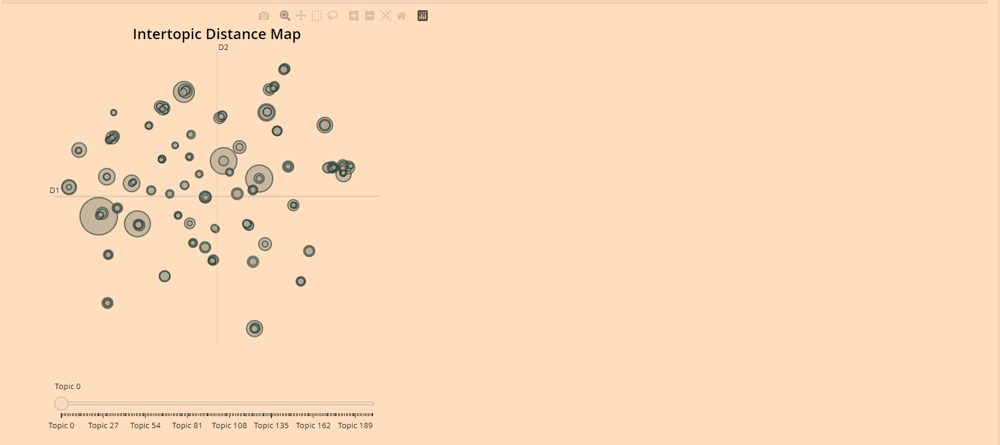
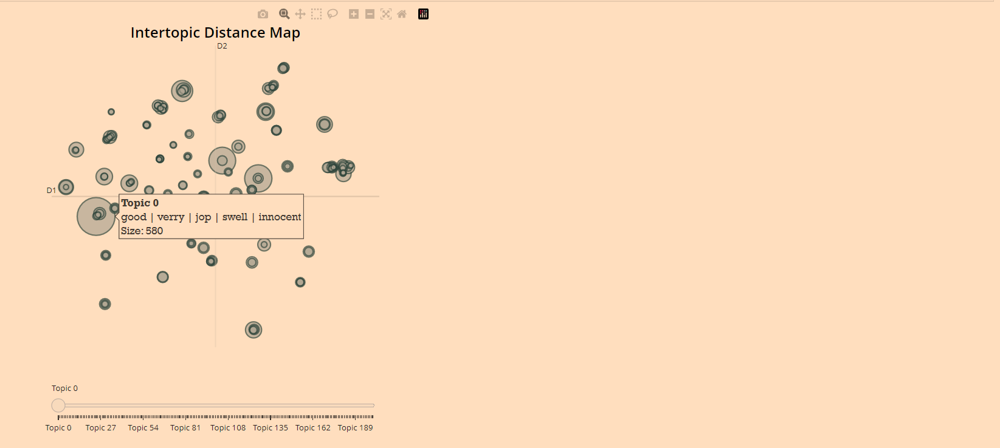
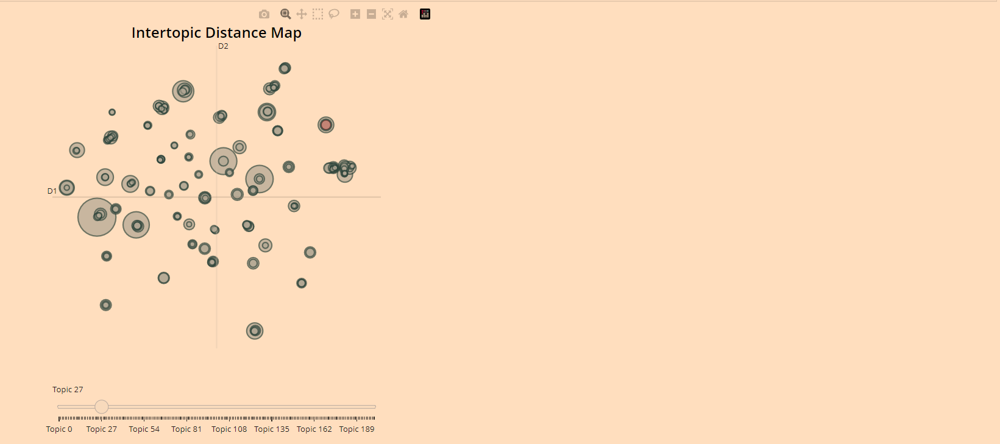

####
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
 2. Topic Bar Chart Visualization
</h4>

**Description:**  
The `topic_model.visualize_barchart()` function generates a bar chart visualization that displays the distribution of topics in the corpus. Each bar represents a topic, and the height of the bar indicates the proportion of documents associated with that topic. This visualization provides an overview of topic prevalence and can assist in identifying the most prominent themes within the text data.

You can use this visualization to gain insights into the composition of topics and their relative significance in the dataset. The x-axis represents the topics, while the y-axis represents the percentage of documents. This visualization is a valuable tool for understanding the distribution of topics and their importance in the analyzed text corpus.

In [ ]:
topic_model.visualize_barchart()

Creating the visualization and saving it.

In [ ]:
import plotly.offline as pyo

# Assuming you have already created the topic_model object
fig = topic_model.visualize_barchart()

# Save the plot to an HTML file
filename = "barchart_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
# pyo.iplot(fig)

In [ ]:
import plotly.offline as pyo

# Assuming you have already created the topic_model object
total_topics = topic_model.get_topic_freq().shape[0]  # Get the total number of topics

# Assuming you have already created the topic_model object
fig = topic_model.visualize_barchart(top_n_topics=total_topics)

# Save the plot to an HTML file
filename = "barchart_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
pyo.iplot(fig)

In [ ]:
from IPython.display import IFrame

# Specify the path to the saved HTML file
saved_html_file = "visualizations for BarTopic/barchart_visualization.html"

# Define the width and height for the embedded iframe (adjust as needed)
iframe_width = "1200px"
iframe_height = "700px"

# Display the saved plot using an iframe
IFrame(saved_html_file, width=iframe_width, height=iframe_height)

In [110]:
from IPython.display import HTML

# URL of the raw HTML file on GitHub
saved_html_file = "https://raw.githubusercontent.com/ZaidAlmelhem/Dashboards/main/Distribution%20of%20Review%20Scores%20for%20Mobile%20Apps/barchart_visualization.html"

# Read the HTML content
html_content = requests.get(saved_html_file).text

# Display the HTML content
HTML(html_content)

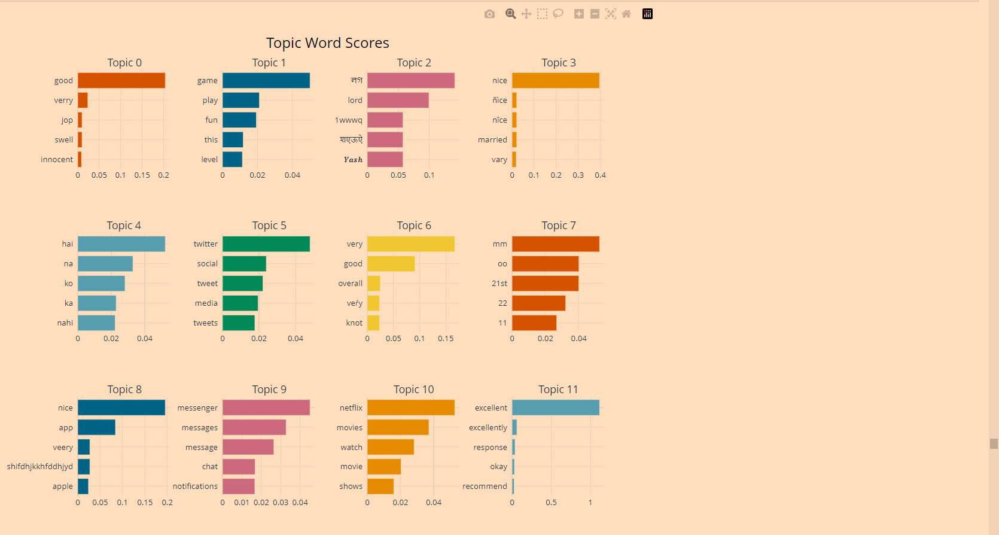
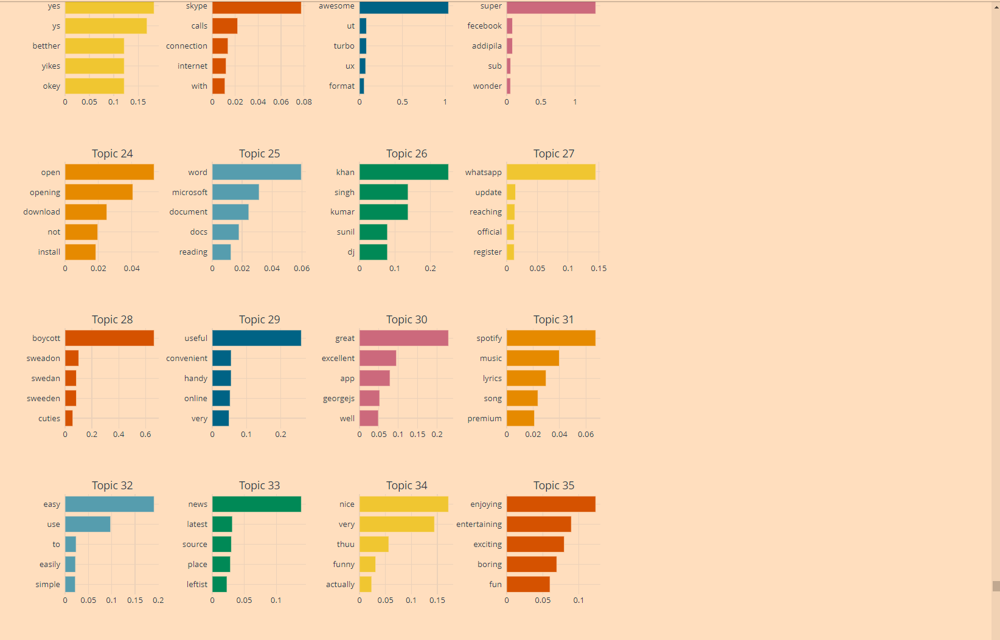
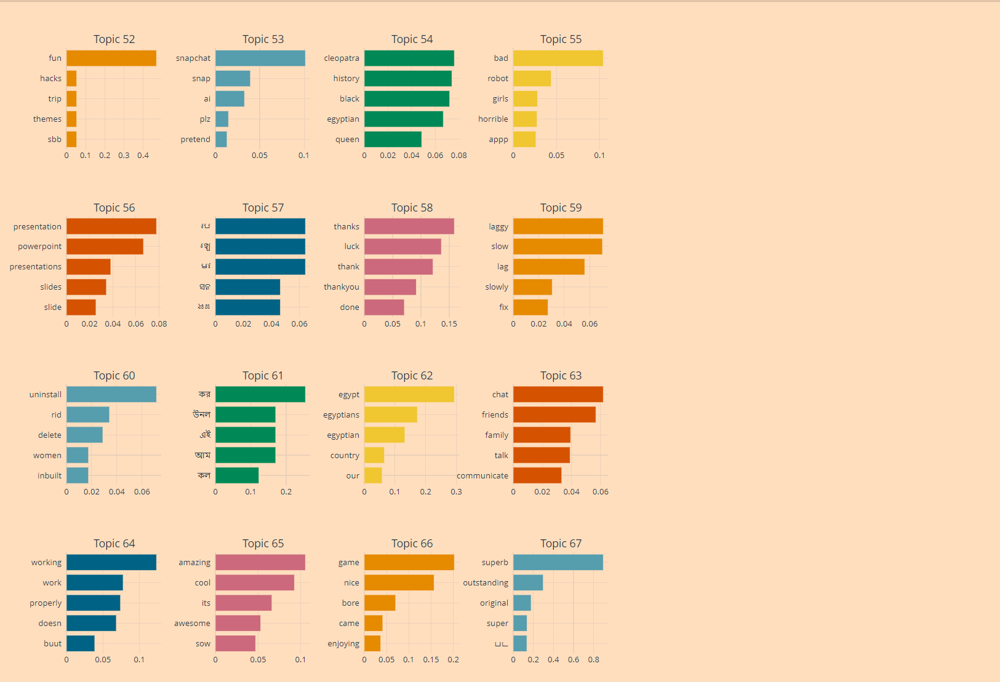

####
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
3. Topic Heatmap Visualization
</h4>


**Description:**  
The `topic_model.visualize_heatmap()` function generates a heatmap visualization that illustrates the correlation between topics in a text corpus. Each cell in the heatmap represents the strength of association between two topics. A color gradient is used to visualize the degree of correlation, with darker shades indicating stronger positive or negative relationships.

This visualization is essential for understanding the interconnections between different topics within the analyzed text data. By identifying topic correlations, you can uncover underlying relationships and dependencies between themes. The heatmap serves as a powerful tool for guiding further analysis and exploration of intricate topic interactions.

In [ ]:
topic_model.visualize_heatmap()

Creating the visualization and saving it.

In [ ]:
topic_model.visualize_heatmap()

import plotly.offline as pyo

# Assuming you have already created the topic_model object
fig = topic_model.visualize_heatmap()

# Save the plot to an HTML file
filename = "heatmap_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
pyo.iplot(fig)

In [ ]:
from IPython.display import IFrame

# Specify the path to the saved HTML file
saved_html_file = "visualizations for BarTopic/heatmap_visualization.html"

# Define the width and height for the embedded iframe (adjust as needed)
iframe_width = "1200px"
iframe_height = "700px"

# Display the saved plot using an iframe
IFrame(saved_html_file, width=iframe_width, height=iframe_height)

In [111]:
from IPython.display import HTML

# URL of the raw HTML file on GitHub
saved_html_file = "https://raw.githubusercontent.com/ZaidAlmelhem/Dashboards/main/Distribution%20of%20Review%20Scores%20for%20Mobile%20Apps/heatmap_visualization.html"

# Read the HTML content
html_content = requests.get(saved_html_file).text

# Display the HTML content
HTML(html_content)

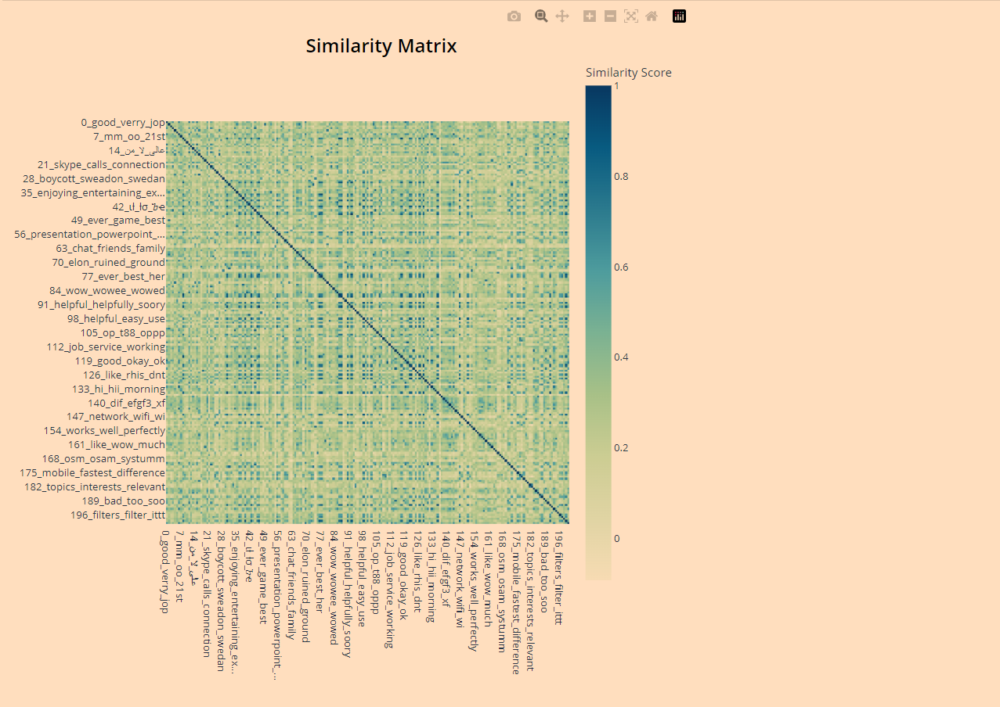
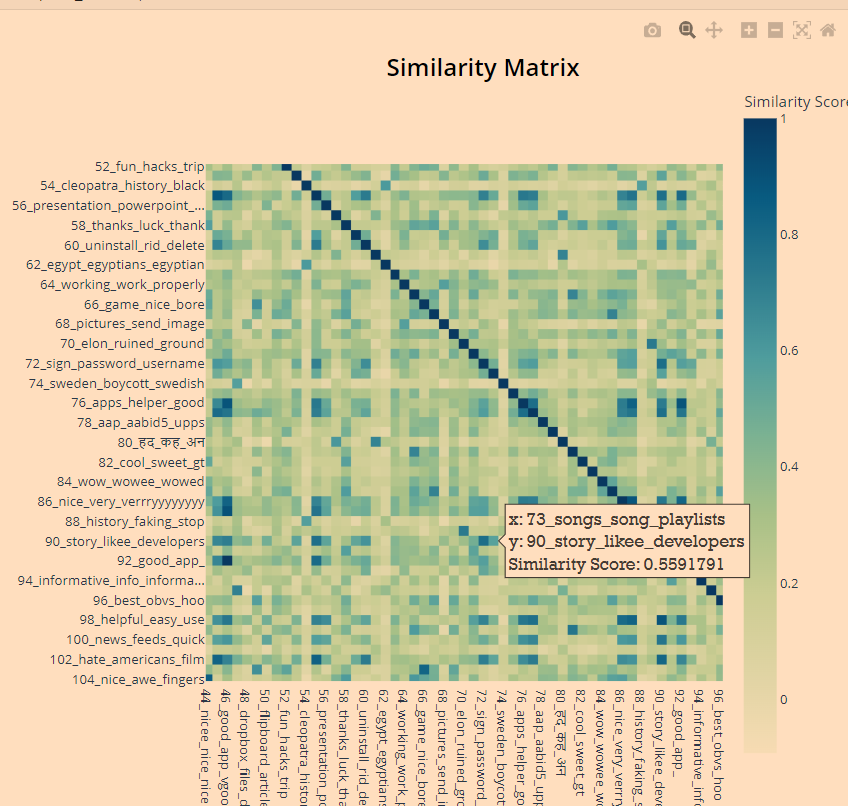
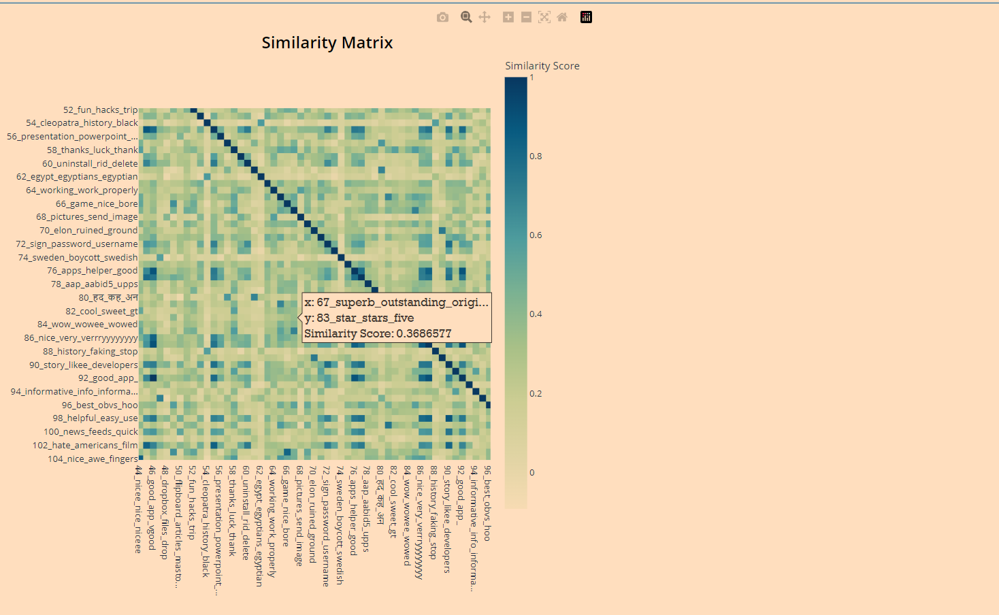
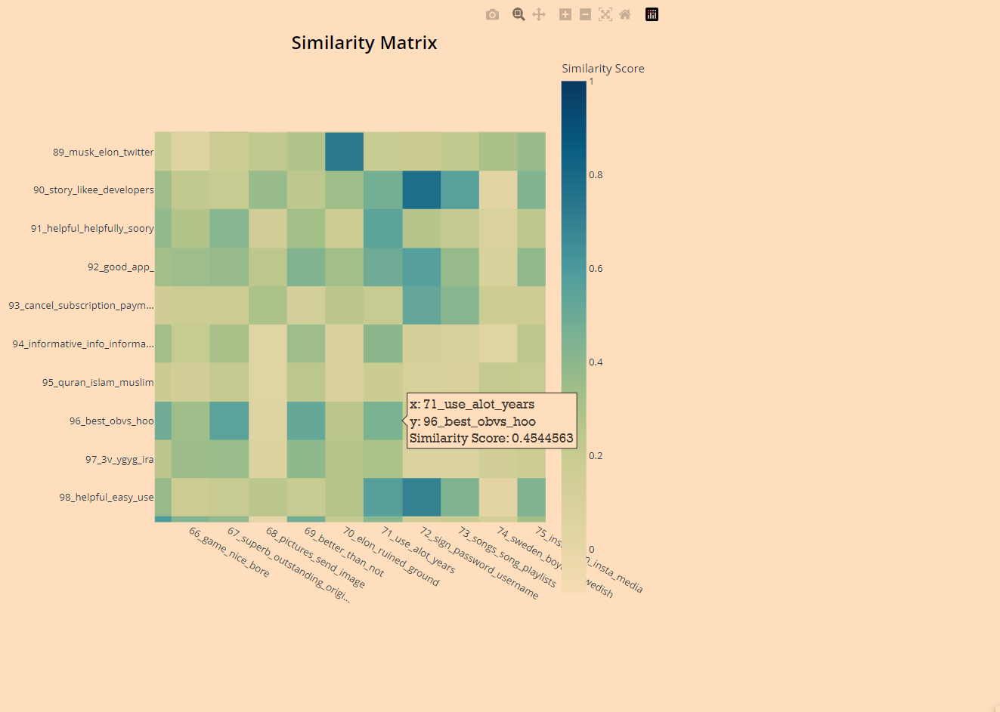

####
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
 4. Visualizing Topic Hierarchy
</h4>


**Description:**
The `topic_model.visualize_hierarchy()` function generates an interactive visualization that provides insights into the hierarchical structure of topics within the document collection. Each node in the hierarchy represents a topic, and the size of the nodes indicates their significance. The connections between nodes illustrate the relationships between topics, with parent and child nodes representing broader and more specific subtopics. This visualization offers a comprehensive view of how topics are organized and interconnected, aiding in the understanding of topic relationships and their relative importance.

In [ ]:
topic_model.visualize_hierarchy()

Creating the visualization and saving it.

In [ ]:
topic_model.visualize_heatmap()

import plotly.offline as pyo

# Assuming you have already created the topic_model object
fig = topic_model.visualize_hierarchy()

# Save the plot to an HTML file
filename = "hierarchy_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
pyo.iplot(fig)

In [ ]:
from IPython.display import IFrame

# Specify the path to the saved HTML file
saved_html_file = "visualizations for BarTopic/hierarchy_visualization.html"

# Define the width and height for the embedded iframe (adjust as needed)
iframe_width = "1200px"
iframe_height = "700px"

# Display the saved plot using an iframe
IFrame(saved_html_file, width=iframe_width, height=iframe_height)

In [112]:
from IPython.display import HTML

# URL of the raw HTML file on GitHub
saved_html_file = "https://raw.githubusercontent.com/ZaidAlmelhem/Dashboards/main/Distribution%20of%20Review%20Scores%20for%20Mobile%20Apps/hierarchy_visualization.html"

# Read the HTML content
html_content = requests.get(saved_html_file).text

# Display the HTML content
HTML(html_content)

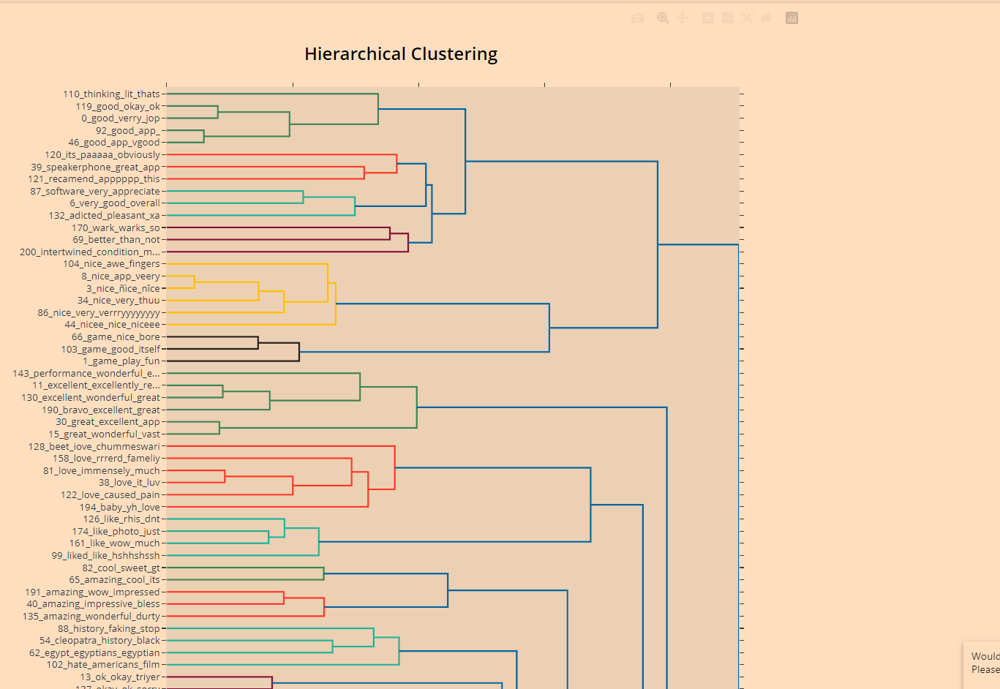

#### 
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
5. Visualizing Term Ranking in Topics
</h4>


**Description:**
The topic_model.visualize_term_rank() function generates a visualization that showcases the most relevant terms within each topic. The visualization presents a bar chart for each topic, where the terms are ranked based on their significance within the topic. The x-axis represents the term ranking, while the y-axis indicates the importance of the terms. This visualization offers valuable insights into the key terms that define and characterize each topic, allowing for a deeper understanding of the content and context of the topics present in the document collection.

In [ ]:
topic_model.visualize_term_rank()
topic_model.visualize_term_rank(log_scale=True)

Creating the visualization and saving it.

In [ ]:
import plotly.offline as pyo

# Assuming you have already created the topic_model object
fig = topic_model.visualize_term_rank(log_scale=True)
# Save the plot to an HTML file
filename = "term_rank_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
pyo.iplot(fig)

In [ ]:
from IPython.display import IFrame

# Specify the path to the saved HTML file
saved_html_file = "visualizations for BarTopic/term_rank_visualization.html"

# Define the width and height for the embedded iframe (adjust as needed)
iframe_width = "1200px"
iframe_height = "700px"

# Display the saved plot using an iframe
IFrame(saved_html_file, width=iframe_width, height=iframe_height)

In [113]:
from IPython.display import HTML

# URL of the raw HTML file on GitHub
saved_html_file = "https://raw.githubusercontent.com/ZaidAlmelhem/Dashboards/main/Distribution%20of%20Review%20Scores%20for%20Mobile%20Apps/term_rank_visualization.html"

# Read the HTML content
html_content = requests.get(saved_html_file).text

# Display the HTML content
HTML(html_content)

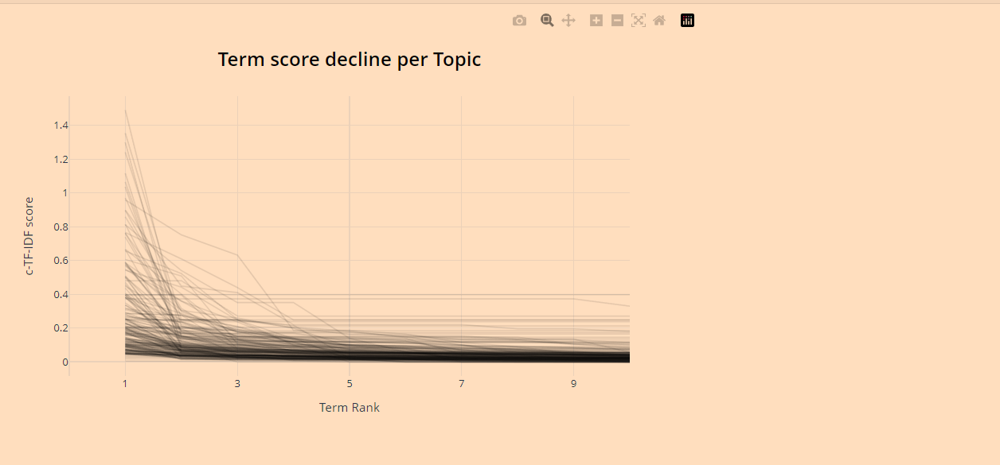
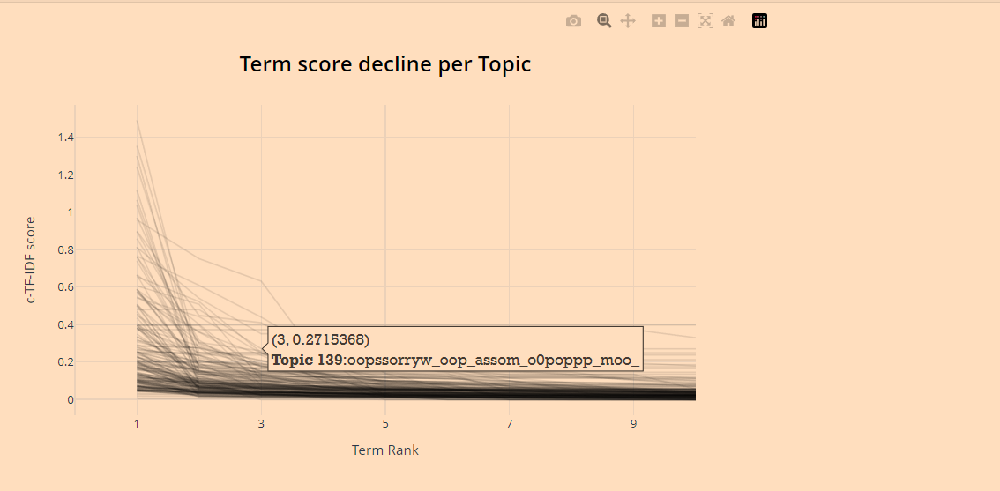

####
<h4 id="import" style="color: #5d0a70; background: #f7dcda; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #1c1c1c;">
6. Visualizing Hierarchical Topic Structure
</h4>


**Description:**
Utilize the `topic_model.visualize_hierarchy()` function in conjunction with `topic_model.hierarchical_topics(docs)` to create an illustrative representation of hierarchical topic relationships. By generating the hierarchical_topics variable and passing it to the visualization function, you can explore the hierarchical arrangement of topics within your document collection. The resulting visualization employs a tree-like structure, where nodes represent individual topics, and branching depicts parent-child relationships between topics. This visualization offers a clear insight into the hierarchical composition of overarching themes and their corresponding subtopics, enhancing your understanding of how topics interconnect and form a cohesive structure. It serves as a valuable tool for comprehending intricate topic hierarchies and aids in the navigation of complex topic relationships.

In [ ]:
hierarchical_topics = topic_model.hierarchical_topics(docs)
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

Creating the visualization and saving it.

In [ ]:
hierarchical_topics = topic_model.hierarchical_topics(sampled_bertopic_df['review'])
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)


import plotly.offline as pyo

# Assuming you have already created the topic_model object
hierarchical_topics = topic_model.hierarchical_topics(sampled_bertopic_df['review'])
fig = topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

# Save the plot to an HTML file
filename = "hierarchical_topics_visualization.html"
pyo.plot(fig, filename=filename)

# Optionally, you can also display the plot in the notebook
pyo.iplot(fig)

In [ ]:
from IPython.display import IFrame

# Specify the path to the saved HTML file
saved_html_file = "visualizations for BarTopic/hierarchical_topics_visualization.html"

# Define the width and height for the embedded iframe (adjust as needed)
iframe_width = "1200px"
iframe_height = "3300px"

# Display the saved plot using an iframe
IFrame(saved_html_file, width=iframe_width, height=iframe_height)

In [114]:
from IPython.display import HTML

# URL of the raw HTML file on GitHub
saved_html_file = "https://raw.githubusercontent.com/ZaidAlmelhem/Dashboards/main/Distribution%20of%20Review%20Scores%20for%20Mobile%20Apps/hierarchical_topics_visualization.html"

# Read the HTML content
html_content = requests.get(saved_html_file).text

# Display the HTML content
HTML(html_content)

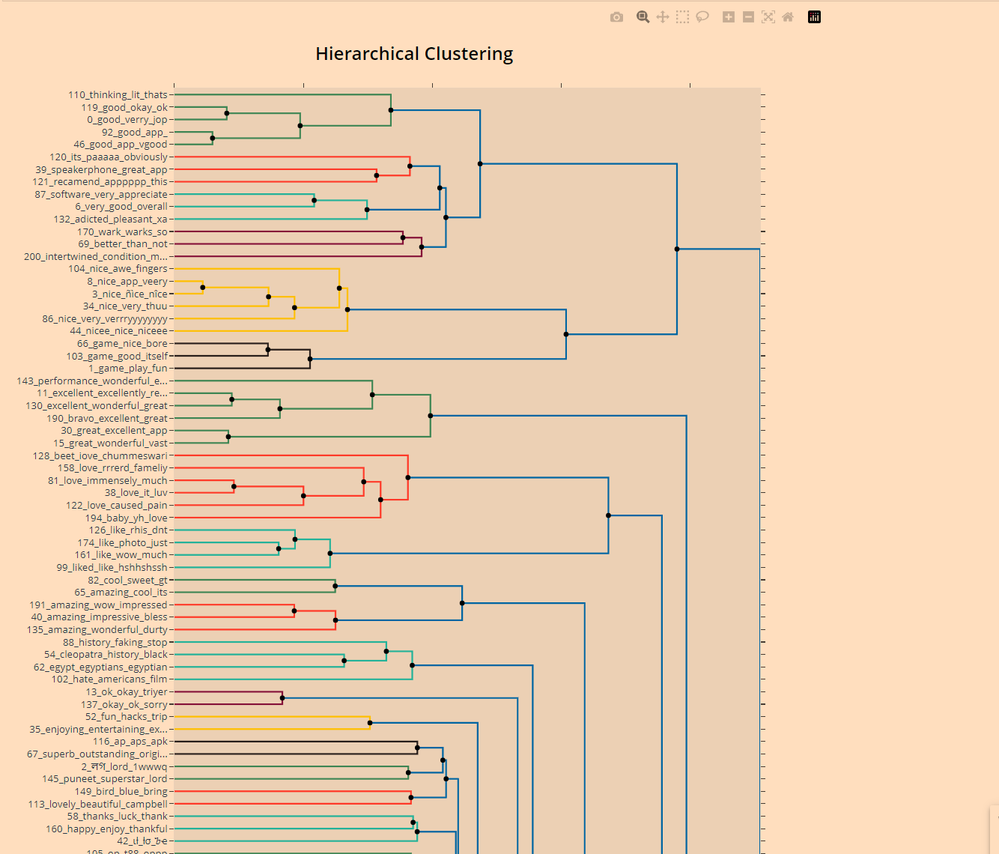
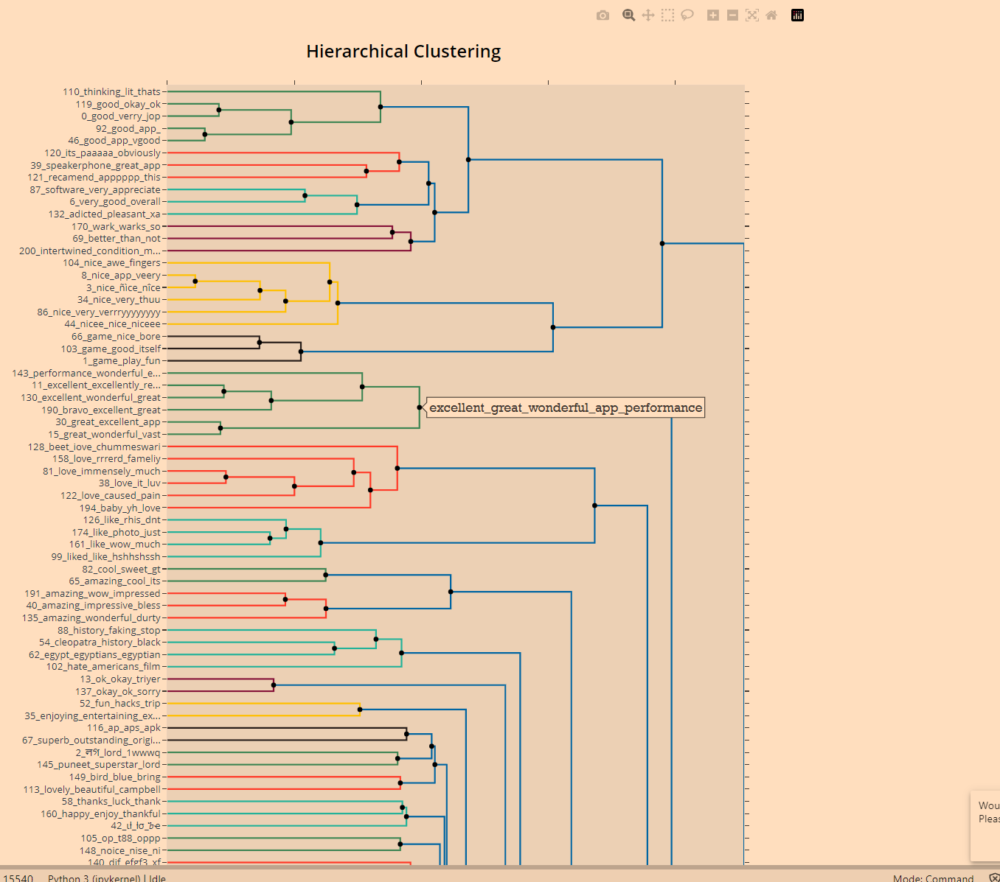
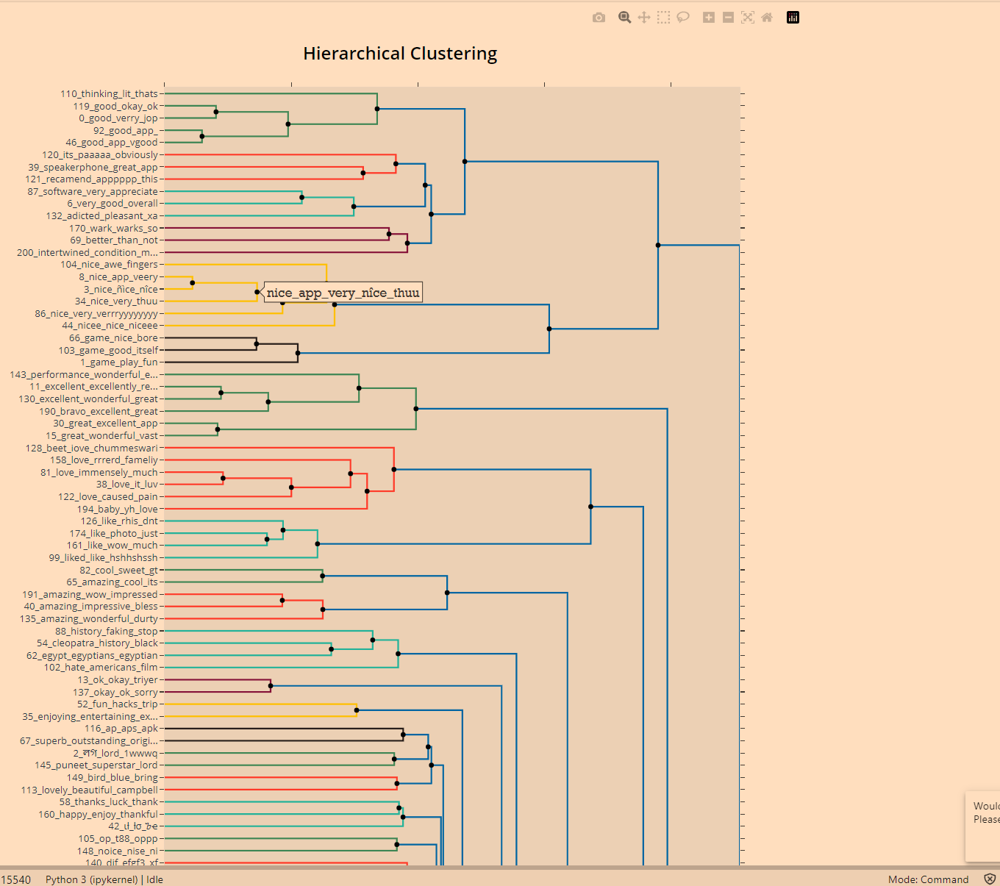

##
----

##
![The End](https://cdn.shopify.com/s/files/1/0070/7032/files/best_20video_20editing_20apps.jpg?v=1683129202)

##
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       Conclusion: Sentiment Analysis and Topic Modeling of Top 20 App Reviews on Google Play Store and Apple Store
    </h2>

In this project, we embarked on a comprehensive journey to analyze and extract valuable insights from the user reviews of the top 20 applications on the Google Play Store and Apple Store. Our exploration spanned across various stages, each contributing to a deeper understanding of the sentiments and topics prevalent within the reviews.

**1. Data Collection:**
We initiated the project by employing web scraping techniques to gather essential app information and user reviews. This step allowed us to amass a rich dataset comprising app names, descriptions, ratings, and user feedback.

**2. Data Preprocessing and EDA (Exploratory Data Analysis):**
With the collected data in hand, we diligently preprocessed it by performing text cleaning, tokenization, and the removal of stop words. This cleansing process paved the way for exploratory data analysis, where we unveiled distribution insights of review scores, discovered common themes, and identified frequently used words within the reviews.

**3. Sentiment Analysis:**
Utilizing advanced natural language processing techniques, particularly BERT-based sentiment analysis, we embarked on a journey to decipher the sentiments expressed in the user reviews. Our sentiment analysis model adeptly categorized each review into positive, negative, or neutral sentiments, enabling a comprehensive assessment of the overall sentiment directed towards each app.

**4. Topic Modeling:**
Our exploration expanded to topic modeling, where we delved into Latent Dirichlet Allocation (LDA) to uncover latent themes and subjects within the reviews. Through this technique, we unearthed key discussion points, gaining a deeper understanding of the underlying topics that dominated user conversations.

**5. Exploring Topic Modeling with BERTopic:**
In a pivotal phase of the project, we embraced the innovative BERTopic approach to unravel intricate patterns within textual data. We navigated the complexities of BERTopic, harnessing its transformative potential to extract coherent and meaningful topics. Practical examples and illuminating visualizations guided us through this exploration, enabling us to uncover the remarkable ability of BERTopic to distill intricate information into interpretable topics.

Through these stages, we have successfully demystified the sentiment and topics embedded within the user reviews of top-ranking applications. Our insights offer valuable recommendations for businesses to optimize content, enhance marketing strategies, and fuel product development. Armed with a deeper comprehension of customer sentiments and prevalent themes, stakeholders can make informed decisions that resonate with user preferences.

In this project, we harnessed the power of data analysis, natural language processing, and innovative topic modeling techniques to extract actionable insights from the digital voices of app users. This journey showcases the immense potential of data-driven exploration in the realm of app reviews, exemplifying how advanced methodologies can unlock a wealth of information and empower businesses to thrive in the digital landscape.

--------

<!-- Contact Me -->

## 📞 Contact Me

Feel free to reach out to me through the following platforms:

[![GitHub](https://img.shields.io/badge/GitHub-%23181717.svg?logo=github&logoColor=white)](https://github.com/YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![LinkedIn](https://img.shields.io/badge/LinkedIn-%230077B5.svg?logo=linkedin&logoColor=white)](https://www.linkedin.com/in/YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![Kaggle](https://img.shields.io/badge/Kaggle-%2320BEFF.svg?logo=kaggle&logoColor=white)](https://www.kaggle.com/YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![Medium](https://img.shields.io/badge/Medium-%2312100E.svg?logo=medium&logoColor=white)](https://medium.com/@YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![Website](https://img.shields.io/badge/Website-%23117AC9.svg?logo=google-chrome&logoColor=white)](https://www.yourwebsite.com)

Connect with me on these platforms to stay updated with my latest projects and articles. I look forward to connecting with you!

<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>